# Определение наиболее прибыльного рекламного источника на примере Яндекс.Афиша

**Целью** данной работы является аналитика в Яндекс.Афише, а именно определение наиболее прибыльного рекламного источника и анализ поведения пользователей, пришедших в разное время из разных каналов, в том числе пользователей использующих различные устройства.

На основании полученных результатов даны реккомендации по оптимизизации маркетинговых затрат.

## Содержание

* [Предобработка и исследовательский анализ данных (EDA)](#chapter1)
* [Анализ метрик](#chapter2)
    * [Продуктовые метрики](#section_2)
        * [Анализ пользовательской активности / DAU, WAU, MAU](#section_2_1)
        * [Количества сессий за период](#section_2_2)
        * [Продолжительность сессий](#section_2_3)
        * [Возврат пользователей / Retention Rate](#section_2_4)
        * [Распределения времени от первого визита до первой покупки](#section_2_5)
        * [Количества покупок за период](#section_2_6)
        * [Количество заказов совершаемых одним пользователем](#section_2_7)
        * [Cредний чек по когортам](#section_2_8)
        * [Анализ выручки / LTV](#section_2_9)
    * [Маркетинговая аналитика](#section_3)
        * [Анализ затрат по источникам](#section_3_1)
        * [Оценка стоимости привлечения одного покупателя из каждого источника](#section_3_2)
        * [Анализ выручки и стоимости привлечения по устройствам](#section_3_3)
        * [Анализ выручки и стоимости привлечения по рекламным каналам](#section_3_4)
        * [ROMI](#section_3_5)
* [Выводы и рекомендации](#chapter5)        


## Предобработка и исследовательский анализ данных (EDA) <a class="anchor" id="chapter1"></a>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')

In [2]:
df_visits = pd.read_csv('/datasets/visits_log.csv')
df_orders = pd.read_csv('/datasets/orders_log.csv')
df_costs = pd.read_csv('/datasets/costs.csv')

#### Датафрейм с логами сервера с данными о посещениях сайта Яндекс.Афиши

In [3]:
df_visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
Device       359400 non-null object
End Ts       359400 non-null object
Source Id    359400 non-null int64
Start Ts     359400 non-null object
Uid          359400 non-null uint64
dtypes: int64(1), object(3), uint64(1)
memory usage: 13.7+ MB


In [4]:
df_visits.head()

,Device,End Ts,Source Id,Start Ts,Uid
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168


В датафрейме `df_visits` содержатся логи сервера с данными о посещениях сайта Яндекс.Афиши.
`Device` - устройство, с которого осуществлен вход;
`End Ts` - дата и время окончания сессии;
`Source Id` - источник трафика;
`Start Ts` - дата и время начала сессии;
`Uid` - уникальный код пользователя.

In [5]:
# переименуем столбцы
df_visits = df_visits.rename(columns={'Device':'device', 'End Ts':'end_ts', 'Source Id':'source_id', 
                                      'Start Ts':'start_ts', 'Uid':'uid'})


In [6]:
# проверка дубликатов
df_visits.duplicated().sum()

0

In [7]:
# преобразование типов данных
df_visits['start_ts'] = pd.to_datetime(df_visits['start_ts'], format='%Y-%m-%d %H:%M')
df_visits['end_ts'] = pd.to_datetime(df_visits['end_ts'], format='%Y-%m-%d %H:%M')
df_visits['uid'] = df_visits['uid'].astype('object')

In [8]:
df_visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
device       359400 non-null object
end_ts       359400 non-null datetime64[ns]
source_id    359400 non-null int64
start_ts     359400 non-null datetime64[ns]
uid          359400 non-null object
dtypes: datetime64[ns](2), int64(1), object(2)
memory usage: 13.7+ MB


In [9]:
df_visits['start_ts'].describe()

count                  359400
unique                 224303
top       2017-11-24 16:06:00
freq                       19
first     2017-06-01 00:01:00
last      2018-05-31 23:59:00
Name: start_ts, dtype: object

#### Датафрейм с данными о заказах за период

In [10]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
Buy Ts     50415 non-null object
Revenue    50415 non-null float64
Uid        50415 non-null uint64
dtypes: float64(1), object(1), uint64(1)
memory usage: 1.2+ MB


In [11]:
df_orders.head()

,Buy Ts,Revenue,Uid
0,2017-06-01 00:10:00,17.00,10329302124590727494
1,2017-06-01 00:25:00,0.55,11627257723692907447
2,2017-06-01 00:27:00,0.37,17903680561304213844
3,2017-06-01 00:29:00,0.55,16109239769442553005
4,2017-06-01 07:58:00,0.37,14200605875248379450


В датафрейме `df_orders` содержатся данные о заказах клиентов. Дата заказа - `Buy Ts`, уникальный номер клиенты `Uid` и сумма каждого заказа `Revenue`.

In [12]:
# Переименуем столбцы
df_orders = df_orders.rename(columns={'Buy Ts':'buy_ts', 'Revenue':'revenue', 'Uid':'uid'})

In [13]:
# Преобразование типов данных
df_orders['buy_ts'] = pd.to_datetime(df_orders['buy_ts'], format='%Y-%m-%d %H:%M')
df_orders['uid'] = df_orders['uid'].astype('object')

In [14]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
buy_ts     50415 non-null datetime64[ns]
revenue    50415 non-null float64
uid        50415 non-null object
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 1.2+ MB


In [15]:
df_orders['buy_ts'].describe()

count                   50415
unique                  45991
top       2018-05-31 10:13:00
freq                        9
first     2017-06-01 00:10:00
last      2018-06-01 00:02:00
Name: buy_ts, dtype: object

In [16]:
df_orders.duplicated().sum()

0

#### Датафрейм с данными о рекламных расходах

In [17]:
df_costs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2542 entries, 0 to 2541
Data columns (total 3 columns):
source_id    2542 non-null int64
dt           2542 non-null object
costs        2542 non-null float64
dtypes: float64(1), int64(1), object(1)
memory usage: 59.7+ KB


In [18]:
df_costs.head()

,source_id,dt,costs
0,1,2017-06-01,75.20
1,1,2017-06-02,62.25
2,1,2017-06-03,36.53
3,1,2017-06-04,55.00
4,1,2017-06-05,57.08


В датафрейме `df_costs` данных о рекламных расходах (`costs`) по дням (`dt`) по различным каналам (`sourse_id`).

In [19]:
# Переименуем столбец
df_costs = df_costs.rename(columns={'dt':'dt_costs'})

In [20]:
# Преобразование типов данных
df_costs['dt_costs'] = pd.to_datetime(df_costs['dt_costs'], format='%Y-%m-%d')

In [21]:
df_costs['dt_costs'].describe()

count                    2542
unique                    364
top       2018-03-03 00:00:00
freq                        7
first     2017-06-01 00:00:00
last      2018-05-31 00:00:00
Name: dt_costs, dtype: object

In [22]:
df_costs.duplicated().sum()

0

Проверка соответствия периодов в датафреймов.

In [23]:
df_orders[df_orders['buy_ts'] > '2018-06-01']

,buy_ts,revenue,uid
50414,2018-06-01 00:02:00,3.42,83872787173869366


В датафреймах `ds_visits`, `ds_costs` временные периоды с июня 2017 по конец мая 2018 года, однако в датафрейме `df_orders` есть одна транзакция 1 июня 2018 года. Для корректности оцениваемых периодов, удалим транзакцию из датафрейма.

In [24]:
df_orders = df_orders.drop(df_orders[df_orders['buy_ts'] > '2018-06-01'].index)

## Анализ метрик <a class="anchor" id="chapter2"></a>

### Продуктовые метрики <a class="anchor" id="section_2"></a>

#### Анализ пользовательской активности / DAU, WAU, MAU  <a class="anchor" id="section_2_1"></a>

- DAU (daily active users) — количество уникальных пользователей в день;
- WAU (weekly active users) — количество уникальных пользователей в неделю;
- MAU (monthly active users) — количество уникальных пользователей в месяц.

In [25]:
df_visits['visit_year'] = df_visits['start_ts'].dt.year
df_visits['visit_month'] = df_visits['start_ts'].dt.month
df_visits['visit_week'] = df_visits['start_ts'].dt.week
df_visits['visit_date'] = df_visits['start_ts'].dt.date

In [26]:
df_visits.head()

,device,end_ts,source_id,start_ts,uid,visit_year,visit_month,visit_week,visit_date
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062,2017,12,51,2017-12-20
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740,2018,2,8,2018-02-19
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527,2017,7,26,2017-07-01
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214,2018,5,20,2018-05-20
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168,2017,12,52,2017-12-27


Посчитаем метрики. Сгруппируем данные по уникальным пользователям и найдём среднее:

In [27]:
dau_total = df_visits.groupby('visit_date').agg({'uid': 'nunique'}).mean()
wau_total = df_visits.groupby(['visit_year', 'visit_week']).agg({'uid': 'nunique'}).mean()
mau_total = df_visits.groupby(['visit_year', 'visit_month']).agg({'uid': 'nunique'}).mean()

In [28]:
print('Количество уникальных пользователей в день -', int(dau_total))
print('Количество уникальных пользователей в неделю -', int(wau_total))
print('Количество уникальных пользователей в месяц -', int(mau_total))

Количество уникальных пользователей в день - 907
Количество уникальных пользователей в неделю - 5716
Количество уникальных пользователей в месяц - 23228


*В среднем сайт Яндекс.Афиши посещает 907 человек в день, 5716 уникальных пользователей в день и 23228 человек в месяц. Данные показатели говорят о том, что пользователи посещают сайт более 1 раза в неделю.*

##### Количестов уникальных пользователей в день (DAU) / Динамика по дням

Text(0.5, 1.0, 'Количестов уникальных пользователей в день (DAU) / Динамика по дням')

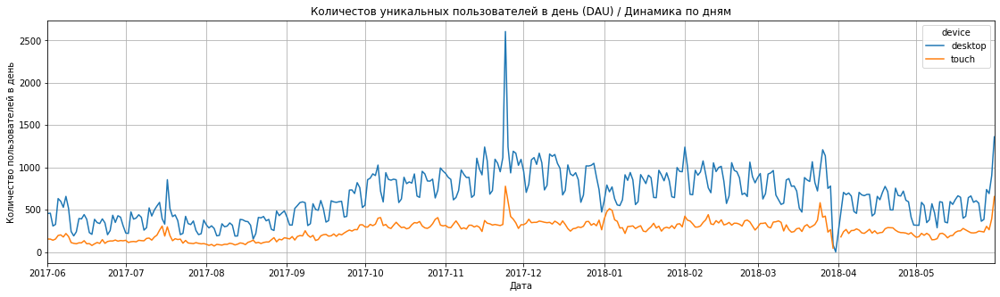

In [29]:
df_visits.pivot_table(index='visit_date', columns = 'device', values='uid', 
                      aggfunc = 'nunique').plot(figsize = (19,5), grid = True)
plt.xlabel('Дата')
plt.ylabel('Количество пользователей в день')
plt.title('Количестов уникальных пользователей в день (DAU) / Динамика по дням')

*Количество посещений с десктопов значительно выше, динамика пропорциональна.*

##### Количестов уникальных пользователей в неделю (WAU) / Динамика по неделям

Text(0.5, 1.0, 'Количестов уникальных пользователей в неделю (WAU) / Динамика по неделям')

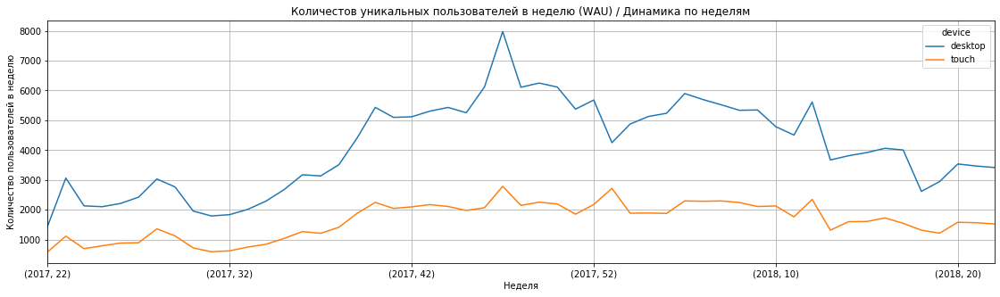

In [30]:
df_visits.pivot_table(index=['visit_year','visit_week'], columns = 'device', values='uid', 
                      aggfunc = 'nunique').plot(figsize = (19,5), grid = True)
plt.xlabel('Неделя')
plt.ylabel('Количество пользователей в неделю')
plt.title('Количестов уникальных пользователей в неделю (WAU) / Динамика по неделям')

##### Количестов уникальных пользователей в месяц (WAU) / Динамика по месяцам

Text(0.5, 1.0, 'Количестов уникальных пользователей в месяц (WAU) / Динамика по месяцам')

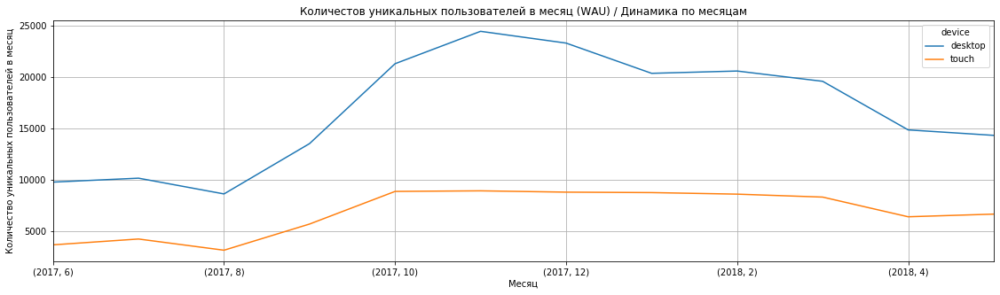

In [31]:
df_visits.pivot_table(index=['visit_year', 'visit_month'], columns = 'device', values='uid', 
                      aggfunc = 'nunique').plot(figsize = (19,5), grid = True)
plt.xlabel('Месяц')
plt.ylabel('Количество уникальных пользователей в месяц')
plt.title('Количестов уникальных пользователей в месяц (WAU) / Динамика по месяцам')

*Пик посещения с десктопов приходится на декабрь, для мобильных устройств динамика в зимние месяцы стагнирует.*

#### Количества сессий за период <a class="anchor" id="section_2_2"></a>

In [32]:
# среднее колчество сессий в день
round(df_visits.groupby('visit_date').agg({'uid': 'count'}).mean(), 2)

uid    987.36
dtype: float64

*В среднем сайт посещают 987 раз в день.*

In [33]:
# количество посещений в день по месяцам
visits_per_user = df_visits.groupby(['visit_year', 'visit_month']).agg({'uid': ['count','nunique']})
visits_per_user.columns = ['n_visits', 'n_users']
visits_per_user['visits_per_user'] = visits_per_user['n_visits'] / visits_per_user['n_users']
visits_per_user['visits_per_user'] = round(visits_per_user['visits_per_user'], 2)

In [34]:
visits_per_user

n_visits  n_users  visits_per_user
visit_year visit_month                                    
2017       6               16505    13259             1.24
           7               17828    14183             1.26
           8               14355    11631             1.23
           9               23907    18975             1.26
           10              37903    29692             1.28
           11              43969    32797             1.34
           12              41983    31557             1.33
2018       1               36939    28716             1.29
           2               37182    28749             1.29
           3               35679    27473             1.30
           4               26515    21008             1.26
           5               26635    20701             1.29

In [35]:
visits_per_user['visits_per_user'].mean().round(2)

1.28

*В среднем один клиент посетил сайт 1,28 раз за месяц за оцениваемый год*

Text(0.5, 1.0, 'Среднее количество посещений в день / Динамика по месяцам')

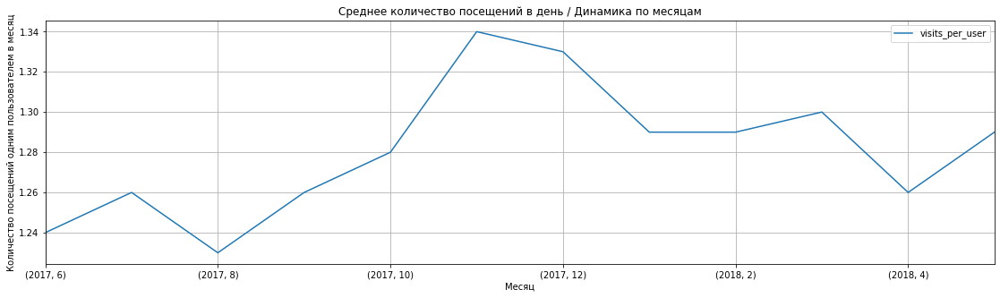

In [36]:
visits_per_user.plot(y = 'visits_per_user', figsize = (19,5), grid = True)
plt.xlabel('Месяц')
plt.ylabel('Количество посещений одним пользователем в месяц')
plt.title('Среднее количество посещений в день / Динамика по месяцам')

*В среднем, наибольшее количество посещений на одного пользователя приходится в ноябре и декабре, это отражает сезонность спроса: вероятно, пользователи заранее планирую новогодние каникулы и чаще посещают Яндекс.Афишу - 1,34 раза в месяц в ноябре и 1,33 раза в декабре. Спад пришелся на август - в среднем пользователи посещали сайт 1,23 раза в месяц.*

### Продолжительность сессий <a class="anchor" id="section_2_3"></a>

In [37]:
df_visits['visit_time_sec'] = (df_visits['end_ts'] - df_visits['start_ts']).dt.seconds

In [38]:
df_visits['visit_time_sec'].describe()

count    359400.000000
mean        643.506489
std        1016.334786
min           0.000000
25%         120.000000
50%         300.000000
75%         840.000000
max       84480.000000
Name: visit_time_sec, dtype: float64

In [39]:
px.histogram(df_visits[df_visits['visit_time_sec'] !=0], x = 'visit_time_sec', range_x=[0, 1000],
            title = 'Продолжительность сессий / Длительность до 1000 секунд', 
            labels = {'visit_time_sec':'Продолжительность в секундах'})

*В среднем, продолжительность одной сессии составляет 300 секунд (медианное значение), однако, на гистограмме видно, что большинство сессий длятся меняя 200 секунд.*

In [40]:
df_visits['visit_time_hour'] = df_visits['visit_time_sec'] / 60 / 60

In [41]:
px.histogram(df_visits[df_visits['visit_time_hour'] !=0], x = 'visit_time_hour', range_x=[0, 2], nbins = 100,
            title = 'Продолжительность сессий / Длительность до 2 часов', 
            labels = {'visit_time_hour':'Продолжительность в часах'})

In [42]:
# расчет показателя длительности посещения
asl = df_visits['visit_time_sec'].mode()
asl

0    60
dtype: int64

*В среднем сессия длится 60 секунд - наибольшее количество посетителей проводят на сайте 60 секунд.*

### Возврат пользователей / Retention Rate <a class="anchor" id="section_2_4"></a>

In [43]:
# дата первого посещения для каждого пользователя
first_visit_date = df_visits.groupby('uid')['visit_date'].min()
first_visit_date.name = 'first_visit_date'
df_visits = df_visits.join(first_visit_date, on = 'uid')

In [44]:
df_visits.head(3)

,device,end_ts,source_id,start_ts,uid,visit_year,visit_month,visit_week,visit_date,visit_time_sec,visit_time_hour,first_visit_date
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062,2017,12,51,2017-12-20,1080,0.300000,2017-12-20
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740,2018,2,8,2018-02-19,1680,0.466667,2018-02-19
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527,2017,7,26,2017-07-01,0,0.000000,2017-07-01


In [45]:
# определим месяц жизни когорты для каждого визита
df_visits['cohort_lifetime'] = df_visits['visit_date'] - df_visits['first_visit_date']
df_visits['cohort_lifetime'] = df_visits['cohort_lifetime'] / np.timedelta64(1,'M')
df_visits['cohort_lifetime'] = df_visits['cohort_lifetime'].round()
df_visits['cohort_lifetime'] = df_visits['cohort_lifetime'].astype('int')

In [46]:
df_visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 13 columns):
device              359400 non-null object
end_ts              359400 non-null datetime64[ns]
source_id           359400 non-null int64
start_ts            359400 non-null datetime64[ns]
uid                 359400 non-null object
visit_year          359400 non-null int64
visit_month         359400 non-null int64
visit_week          359400 non-null int64
visit_date          359400 non-null object
visit_time_sec      359400 non-null int64
visit_time_hour     359400 non-null float64
first_visit_date    359400 non-null object
cohort_lifetime     359400 non-null int64
dtypes: datetime64[ns](2), float64(1), int64(6), object(4)
memory usage: 35.6+ MB


In [47]:
# перевод когорты к месяцу
df_visits['first_visit_month'] = df_visits['first_visit_date'].astype('datetime64[M]')

In [48]:
cohorts = (df_visits
           .groupby(['first_visit_month','cohort_lifetime'])
           .agg({'uid':'nunique'}).reset_index()
          )
cohorts

,first_visit_month,cohort_lifetime,uid
0,2017-06-01,0,13259
1,2017-06-01,1,976
2,2017-06-01,2,718
3,2017-06-01,3,805
4,2017-06-01,4,910
...,...,...,...
85,2018-04-01,0,15709
86,2018-04-01,1,622
87,2018-04-01,2,68
88,2018-05-01,0,15273


In [49]:
# подсчет колличества пользователей в когортах в первый месяц
initial_users_count = cohorts[cohorts['cohort_lifetime'] == 0][['first_visit_month','uid']]
initial_users_count = initial_users_count.rename(columns={'uid':'cohort_users'})
# добавление и исходный дф количества пользователей в когорте
cohorts = cohorts.merge(initial_users_count, on='first_visit_month')
cohorts['retantion'] = cohorts['uid'] / cohorts['cohort_users'] 
cohorts.sample(5)

,first_visit_month,cohort_lifetime,uid,cohort_users,retantion
59,2017-11-01,4,854,27248,0.031342
41,2017-09-01,5,672,16704,0.040230
86,2018-04-01,1,622,15709,0.039595
81,2018-03-01,0,20589,20589,1.000000
16,2017-07-01,3,699,13140,0.053196


In [50]:
retention = cohorts.pivot_table(index = 'first_visit_month', columns = 'cohort_lifetime', 
                                values = 'retantion', aggfunc = 'mean')
retention.fillna('')

cohort_lifetime,0,1,2,3,4,5,6,7,8,9,10,11,12
first_visit_month,,,,,,,,,,,,,
2017-06-01,1.0,0.073610,0.0541519,0.0607135,0.0686326,0.0671996,0.0636549,0.0560374,0.0556603,0.05023,0.041255,0.0402745,0.0125952
2017-07-01,1.0,0.056240,0.0523592,0.0531963,0.0561644,0.0493151,0.0446728,0.0496956,0.036758,0.0296043,0.0239726,0.00547945,
2017-08-01,1.0,0.068952,0.0621746,0.0587369,0.0507809,0.0428249,0.0410569,0.0343778,0.0289755,0.0233769,0.00284844,,
2017-09-01,1.0,0.075670,0.0672893,0.0489104,0.0395115,0.0402299,0.033046,0.0261015,0.0198156,0.00257423,,,
2017-10-01,1.0,0.073103,0.0529699,0.0379951,0.0361089,0.0313739,0.0210956,0.0179774,0.00323363,,,,
2017-11-01,1.0,0.068739,0.0468291,0.038278,0.0313417,0.024222,0.0184968,0.0027525,,,,,
2017-12-01,1.0,0.050974,0.0410796,0.0289299,0.0215688,0.0163844,0.0027703,,,,,,
2018-01-01,1.0,0.053439,0.0362889,0.0255481,0.0171499,0.00194484,,,,,,,
2018-02-01,1.0,0.047889,0.0268505,0.0180205,0.0020273,,,,,,,,


Text(93.49999999999999, 0.5, 'Дата первого посещения')

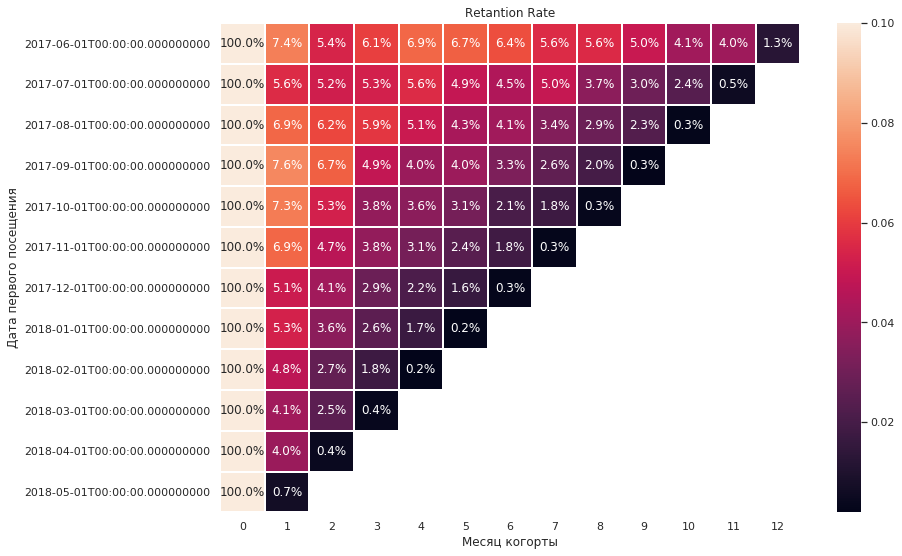

In [51]:
# тепловая карта показателя возврата клиентов
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('Retantion Rate')
sns.heatmap(retention, vmax=0.1, annot=True, fmt='.1%', linewidths=1, linecolor='white')
plt.xlabel('Месяц когорты')
plt.ylabel('Дата первого посещения')

*В среднем отток клиентов сохраняется на одном уровне по всем когортам. Для тех, кто пришел в сентябре 2017 года возврат во второй и третий месяцы наивысший среди всех когорт, однако для более возврастных (первых) когорт характерна большая стабильность - спустя год, возврат клиентов 1.3%, в то время, как для последующих когорт, возврат достигает 1 процента уже к 5 месяцу. Для майской когорты, возврат во второй месяц равен всего 0.7%.*

### Распределения времени от первого визита до первой покупки  <a class="anchor" id="section_2_5"></a>

In [52]:
# первый визит
first_visit = df_visits.sort_values(by = ['uid','start_ts']).groupby('uid').agg({'start_ts':'first'})

In [53]:
# первая покупка
first_order = df_orders.sort_values(by = ['uid','buy_ts']).groupby('uid').agg({'buy_ts':'first'})

In [54]:
# количество польлзователей с заказами
len(first_order)

36522

In [55]:
visits_orders = first_order.merge(first_visit, on = 'uid').reset_index()
visits_orders.sample(3)

,uid,buy_ts,start_ts
8120,4096603975948930813,2017-11-08 16:33:00,2017-11-08 16:11:00
12762,6377362727348825112,2017-12-11 12:35:00,2017-12-11 12:05:00
12537,6266991366688373922,2017-12-11 11:23:00,2017-12-11 11:15:00


In [56]:
# период между входом на сайт и покупкой
visits_orders['time_delta'] = visits_orders['buy_ts'] - visits_orders['start_ts']
visits_orders['time_delta'] = visits_orders['time_delta'].dt.total_seconds()

In [57]:
visits_orders['time_delta_min'] = visits_orders['time_delta'] / 60
visits_orders['time_delta_min'].describe()

count     36522.000000
mean      24340.842205
std       67785.583078
min           0.000000
25%           4.000000
50%          16.000000
75%        2897.500000
max      523144.000000
Name: time_delta_min, dtype: float64

In [58]:
fig = px.histogram(visits_orders, x="time_delta_min", nbins = 10)
fig.update_layout(
    title_text='Гистограмма распределения времени от первого визита до первой покупки', 
    xaxis_title_text='Минуты',
    yaxis_title_text='Количество клиентов')
fig.show()

*Большинство пользователей (50%) совершают первый заказ в течении 16 минут с момента первого посещения сайта. Четверть принимает решение о покупке в течении 4 минут (вероятно, это постоянные клиенты, которые целеноправленно заходят на сайт для покупки и не тратят время на выбор.*

### Количества покупок за период   <a class="anchor" id="section_2_6"></a>

In [59]:
df_orders.sample(3)

,buy_ts,revenue,uid
13514,2017-10-19 08:24:00,6.11,8774634485582238747
30684,2018-01-23 15:54:00,0.92,17598817472401159103
13434,2017-10-18 16:50:00,45.83,13620550651017262232


In [60]:
df_orders['order_date'] = df_orders['buy_ts'].astype('datetime64[M]')
df_orders['order_week'] = df_orders['buy_ts'].dt.week

In [61]:
order_monthly = df_orders.groupby('order_date')['uid'].agg({'uid':'nunique'}).reset_index()
order_monthly

,order_date,uid
0,2017-06-01,2023
1,2017-07-01,1984
2,2017-08-01,1472
3,2017-09-01,2750
4,2017-10-01,4675
5,2017-11-01,4547
6,2017-12-01,4942
7,2018-01-01,3898
8,2018-02-01,4258
9,2018-03-01,4181


In [62]:
fig = px.line(order_monthly, x='order_date', y = 'uid', title='Количество заказов по месяцам', 
              labels={'order_date':'Месяц заказа', 'uid':'Количетсво заказов'})

fig.show()

*Большинство заказов оформляются в предверии нового года: с октября по декабрь, с характерным снижением количества заказов в январе.*

In [63]:
df_orders.groupby('order_date')['uid'].agg({'uid':'nunique'}).median()

uid    3721.0
dtype: float64

In [64]:
orders_weekly = df_orders.groupby('order_week')['uid'].agg({'uid':'nunique'}).reset_index()
px.line(orders_weekly, x='order_week', y="uid", title='Количество заказов по неделям', 
        labels={'order_week':'Календарная неделя заказа', 'uid':'Количетсво заказов'})

*На графике видны 4 характерных пика: в конце июня, начале октября, конце ноября и последней неделе года.*

### Количество заказов совершаемых одним пользователем <a class="anchor" id="section_2_7"></a>

In [65]:
orders_per_user = df_orders.groupby('uid').agg({'uid':'count'})
orders_per_user = orders_per_user.rename(columns={'uid':'n_orders'})
orders_per_user = orders_per_user.reset_index()
orders_per_user['n_orders'].describe()

count    36522.000000
mean         1.380373
std          3.454508
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max        239.000000
Name: n_orders, dtype: float64

In [66]:
px.histogram(orders_per_user[orders_per_user['n_orders']<5], x = 'n_orders', nbins = 5,
             title = 'Количество заказов совершаемых одним пользователем', labels = {'n_orders':'Количество заказов'})

In [67]:
orders_per_user['n_orders'].mode()

0    1
dtype: int64

*Большинство пользователей совершают 1 заказ.*

### Cредний чек по когортам <a class="anchor" id="section_2_8"></a>

In [68]:
revenue_monthly = df_orders.groupby('order_date')[['uid','revenue']].agg({'uid':'count', 'revenue':'sum'}).reset_index()

In [69]:
revenue_monthly['avg_transaction_sum'] = revenue_monthly['revenue'] / revenue_monthly['uid']
revenue_monthly

,order_date,uid,revenue,avg_transaction_sum
0,2017-06-01,2354,9557.49,4.060106
1,2017-07-01,2363,12539.47,5.306589
2,2017-08-01,1807,8758.78,4.847139
3,2017-09-01,3387,18345.51,5.416448
4,2017-10-01,5679,27987.70,4.928280
5,2017-11-01,5659,27069.93,4.783518
6,2017-12-01,6218,36388.60,5.852139
7,2018-01-01,4721,19417.13,4.112927
8,2018-02-01,5281,25560.54,4.840095
9,2018-03-01,5326,28834.59,5.413930


In [70]:
fig = px.line(revenue_monthly, x='order_date', y = 'avg_transaction_sum', title='Средний чек по месяцам',
             labels={'order_date':'Календарный месяц', 'avg_transaction_sum':'Средний чек'})
fig.show()

*Наивысший средний чек в декабре (как мы помним, в это период также совершается большое количество заказов, характерная сезонность), наименьший в свою очередь, в январе. В остальное время, средний чек примерно одинаков.*

In [71]:
first_order_date = df_orders.groupby('uid')['order_date'].min()
first_order_date.name = 'first_order_date'
df_orders = df_orders.join(first_order_date, on = 'uid')
df_orders['cohort_lifetime'] = df_orders['first_order_date'].astype('datetime64[M]')

df_orders['cohort_lifetime'] = df_orders['order_date'] - df_orders['first_order_date']
df_orders['cohort_lifetime'] = df_orders['cohort_lifetime'] / np.timedelta64(1,'M')
df_orders['cohort_lifetime'] = df_orders['cohort_lifetime'].round()
df_orders['cohort_lifetime'] = df_orders['cohort_lifetime'].astype('int')

In [72]:
df_orders['cohort_lifetime'].value_counts()

0     41587
1      2404
2      1519
3      1221
4       945
5       738
6       682
7       483
8       377
9       223
10      149
11       86
Name: cohort_lifetime, dtype: int64

In [73]:
cohorts_by_orders = (df_orders
                     .groupby(['first_order_date','cohort_lifetime'])[['uid','revenue']]
                     .agg({'uid':'count','revenue':'sum',}).reset_index()
          )
cohorts_by_orders['avg_trans'] = cohorts_by_orders['revenue'] /cohorts_by_orders['uid'] 
cohorts_by_orders['avg_trans'] = cohorts_by_orders['avg_trans'].round(2)
cohorts_by_orders.sample(5)

,first_order_date,cohort_lifetime,uid,revenue,avg_trans
13,2017-07-01,1,100,644.61,6.45
56,2017-11-01,6,102,469.02,4.60
10,2017-06-01,10,96,1155.66,12.04
63,2018-01-01,0,3783,13949.50,3.69
14,2017-07-01,2,120,1199.05,9.99


In [74]:
transaction = cohorts_by_orders.pivot_table(index = 'first_order_date', columns = 'cohort_lifetime',
                                            values = 'avg_trans', aggfunc = 'mean')
transaction.fillna('')

cohort_lifetime,0,1,2,3,4,5,6,7,8,9,10,11
first_order_date,,,,,,,,,,,,
2017-06-01,4.06,5.55,5.09,8.55,7.08,6.83,6.97,6.76,5.28,8.01,12.04,6.04
2017-07-01,5.29,6.45,9.99,6.64,4.72,3.66,3.79,5.45,5.35,11.79,5.65,
2017-08-01,4.72,5.99,6.28,6.62,7.96,6.27,5.89,7.11,8.7,5.6,,
2017-09-01,4.97,13.17,8.35,62.57,15.43,15.32,16.77,11.21,7.79,,,
2017-10-01,4.37,7.41,5.13,5.59,5.1,5.07,4.28,4.01,,,,
2017-11-01,4.37,4.1,4.47,6.28,4.44,3.73,4.6,,,,,
2017-12-01,4.11,4.23,20.07,26.08,15.95,14.11,,,,,,
2018-01-01,3.69,4.44,6.45,7.52,2.71,,,,,,,
2018-02-01,3.71,4.58,3.45,3.87,,,,,,,,


Text(93.49999999999999, 0.5, 'Дата первого заказа')

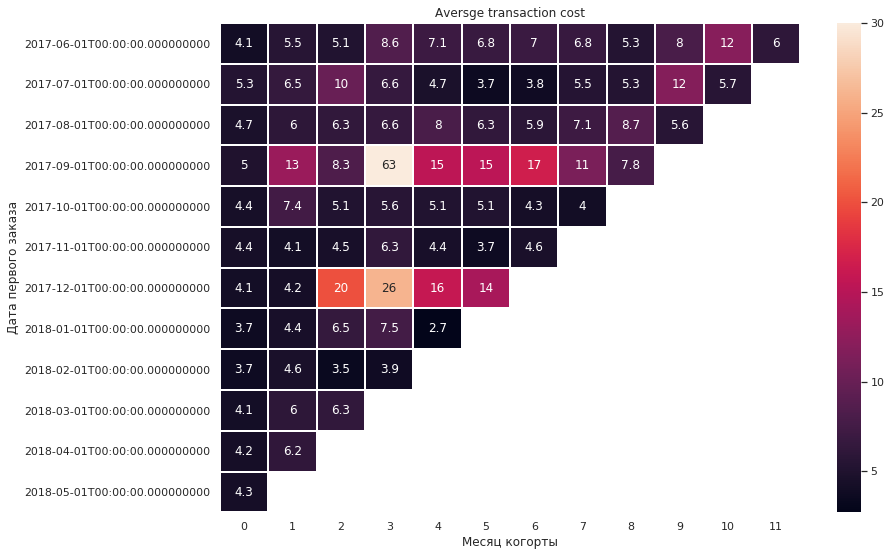

In [75]:
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('Aversge transaction cost')
sns.heatmap(transaction, vmax=30, annot=True, linewidths=1, linecolor='white')
plt.xlabel('Месяц когорты')
plt.ylabel('Дата первого заказа')

*Аномальным вяглядит средний чек для сентябрьской когорты, на 4 месяц этот показатель наивысший (возиожно ошибка?). Также, наивысший средний чек, при том, сохраняющийся на относительно высоком уровна у пользователей, что совершили первый заказ в декабре, начиная с февраля, средний чек когорты выше остальных (возможно люди пришли с одного канала?). Для остальных когорт средний чек сохраняет стабильность.*

### Анализ выручки / LTV <a class="anchor" id="section_2_9"></a>

In [76]:
df_costs

,source_id,dt_costs,costs
0,1,2017-06-01,75.20
1,1,2017-06-02,62.25
2,1,2017-06-03,36.53
3,1,2017-06-04,55.00
4,1,2017-06-05,57.08
...,...,...,...
2537,10,2018-05-27,9.92
2538,10,2018-05-28,21.26
2539,10,2018-05-29,11.32
2540,10,2018-05-30,33.15


In [77]:
df_costs['month_cost'] = df_costs['dt_costs'].astype('datetime64[M]')

In [78]:
df_costs_month = df_costs.groupby('month_cost')['costs'].sum().reset_index()
df_costs_month

,month_cost,costs
0,2017-06-01,18015.00
1,2017-07-01,18240.59
2,2017-08-01,14790.54
3,2017-09-01,24368.91
4,2017-10-01,36322.88
5,2017-11-01,37907.88
6,2017-12-01,38315.35
7,2018-01-01,33518.52
8,2018-02-01,32723.03
9,2018-03-01,30415.27


In [79]:
first_order = df_orders[['uid','first_order_date']]

In [80]:
cohort_sizes = first_order.groupby('first_order_date').agg({'uid':'nunique'}).reset_index()
cohort_sizes.columns = ['first_order_date','n_buyers']
cohort_sizes

,first_order_date,n_buyers
0,2017-06-01,2023
1,2017-07-01,1923
2,2017-08-01,1370
3,2017-09-01,2581
4,2017-10-01,4340
5,2017-11-01,4081
6,2017-12-01,4383
7,2018-01-01,3373
8,2018-02-01,3651
9,2018-03-01,3533


In [81]:
cohorts_ltv = df_orders.groupby(['first_order_date','order_date']).agg({'revenue':'sum'}).reset_index()
cohorts_ltv

,first_order_date,order_date,revenue
0,2017-06-01,2017-06-01,9557.49
1,2017-06-01,2017-07-01,981.82
2,2017-06-01,2017-08-01,885.34
3,2017-06-01,2017-09-01,1931.30
4,2017-06-01,2017-10-01,2068.58
...,...,...,...
73,2018-03-01,2018-04-01,1063.05
74,2018-03-01,2018-05-01,1114.87
75,2018-04-01,2018-04-01,10600.69
76,2018-04-01,2018-05-01,1209.92


In [82]:
report = pd.merge(cohort_sizes, cohorts_ltv, on='first_order_date')
report['age'] = (report['order_date'] - report['first_order_date']) / np.timedelta64(1,'M')
report['age'] = report['age'].round().astype('int')
report['ltv'] = report['revenue'] / report['n_buyers']
report

,first_order_date,n_buyers,order_date,revenue,age,ltv
0,2017-06-01,2023,2017-06-01,9557.49,0,4.724414
1,2017-06-01,2023,2017-07-01,981.82,1,0.485329
2,2017-06-01,2023,2017-08-01,885.34,2,0.437637
3,2017-06-01,2023,2017-09-01,1931.30,3,0.954671
4,2017-06-01,2023,2017-10-01,2068.58,4,1.022531
...,...,...,...,...,...,...
73,2018-03-01,3533,2018-04-01,1063.05,1,0.300892
74,2018-03-01,3533,2018-05-01,1114.87,2,0.315559
75,2018-04-01,2276,2018-04-01,10600.69,0,4.657597
76,2018-04-01,2276,2018-05-01,1209.92,1,0.531599


In [83]:
ltv = report.pivot_table(index = 'first_order_date', columns = 'age', values='ltv', aggfunc='mean').round(2)
ltv.fillna("")
ltv = ltv.cumsum(axis=1)

Text(93.49999999999999, 0.5, 'Дата первого заказа')

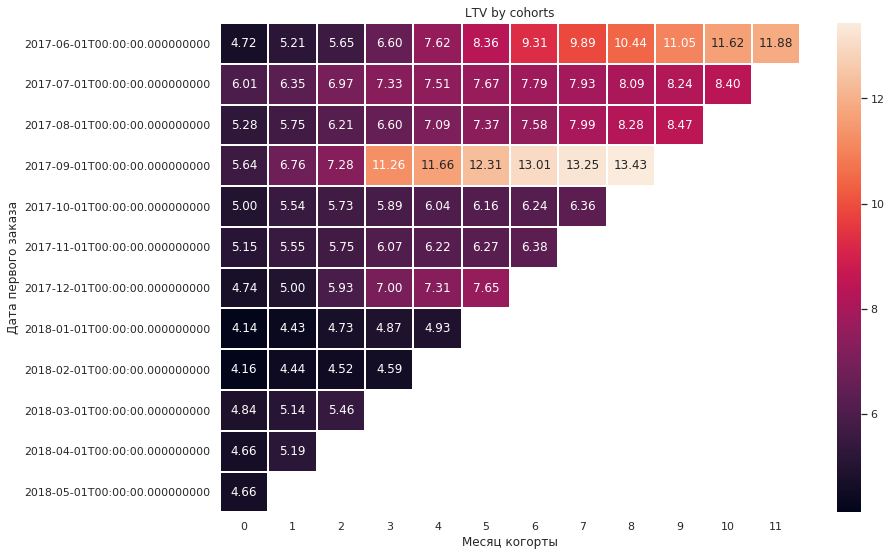

In [84]:
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('LTV by cohorts')
sns.heatmap(ltv, annot=True, linewidths=1,  fmt='.2f', linecolor='white')
plt.xlabel('Месяц когорты')
plt.ylabel('Дата первого заказа')

*Жизненная ценность клиента рассчитана куммулятивно по когортам. На тепловой карте мы видим, что наибольшую суммарную прибыль принося пользователи, совершившие первый заказ в декабре 2017 года. Также, среди когорт, приносящий наибольшую прибыль стоит выделить июньскую, июльскую и сентябрьскую, клиенты продолжают совершать покупки и приносят больше денег, чем остальные. Среди новых, можно выделить декабрьскую когорту.*

## Маркетинговая аналитика <a class="anchor" id="chapter3"></a>

### Оценка затрат по источникам <a class="anchor" id="section_3_1"></a>

In [85]:
# оценка суммарных завтра за период
fig = px.line(df_costs_month, x='month_cost', y = 'costs', title='Расходы по месяцам', 
              labels={'month_cost': 'Месяц','costs': 'Суммарные расходы'})
fig.show()

In [86]:
print('Суммарные расходы за год -',df_costs['costs'].sum().round())

Суммарные расходы за год - 329132.0


*За год на рекламу было потрачено 329 132, максимальные затраты приходятся на октябрь-ноябрь-декарь.*

In [87]:
# стоимость привлечения
report_new = pd.merge(report, df_costs_month, left_on = 'order_date', right_on = 'month_cost')
report_new['cac'] = report_new['costs'] / report_new['n_buyers']
report_new['romi'] = report_new['ltv'] / report_new['cac']
report_new

,first_order_date,n_buyers,order_date,revenue,age,ltv,month_cost,costs,cac,romi
0,2017-06-01,2023,2017-06-01,9557.49,0,4.724414,2017-06-01,18015.00,8.905091,0.530530
1,2017-06-01,2023,2017-07-01,981.82,1,0.485329,2017-07-01,18240.59,9.016604,0.053826
2,2017-07-01,1923,2017-07-01,11557.65,0,6.010218,2017-07-01,18240.59,9.485486,0.633623
3,2017-06-01,2023,2017-08-01,885.34,2,0.437637,2017-08-01,14790.54,7.311191,0.059859
4,2017-07-01,1923,2017-08-01,644.61,1,0.335211,2017-08-01,14790.54,7.691388,0.043583
...,...,...,...,...,...,...,...,...,...,...
73,2018-01-01,3373,2018-05-01,211.48,4,0.062698,2018-05-01,22224.27,6.588873,0.009516
74,2018-02-01,3651,2018-05-01,270.70,3,0.074144,2018-05-01,22224.27,6.087173,0.012180
75,2018-03-01,3533,2018-05-01,1114.87,2,0.315559,2018-05-01,22224.27,6.290481,0.050165
76,2018-04-01,2276,2018-05-01,1209.92,1,0.531599,2018-05-01,22224.27,9.764618,0.054441


In [88]:
# затраты по каналам
costs_pivot = df_costs.pivot_table(index = 'month_cost', columns = 'source_id', values = 'costs', aggfunc='sum')
costs_pivot

source_id,1,2,3,4,5,9,10
month_cost,,,,,,,
2017-06-01,1125.61,2427.38,7731.65,3514.80,2616.12,285.22,314.22
2017-07-01,1072.88,2333.11,7674.37,3529.73,2998.14,302.54,329.82
2017-08-01,951.81,1811.05,6143.54,3217.36,2185.28,248.93,232.57
2017-09-01,1502.01,2985.66,9963.55,5192.26,3849.14,415.62,460.67
2017-10-01,2315.75,4845.00,15737.24,6420.84,5767.40,609.41,627.24
2017-11-01,2445.16,5247.68,17025.34,5388.82,6325.34,683.18,792.36
2017-12-01,2341.20,4897.80,16219.52,7680.47,5872.52,657.98,645.86
2018-01-01,2186.18,4157.74,14808.78,5832.79,5371.52,547.16,614.35
2018-02-01,2204.48,4474.34,14228.56,5711.96,5071.31,551.50,480.88


Text(0.5, 1.0, 'Затраты по каналам по месяцам')

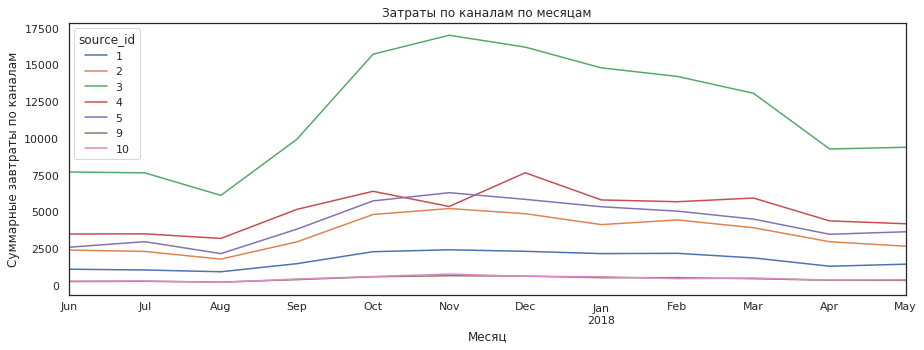

In [89]:
# динамика завтрат по каналам
costs_pivot.plot(figsize=(15,5))
plt.xlabel('Месяц')
plt.ylabel('Суммарные завтраты по каналам')
plt.title('Затраты по каналам по месяцам')

*На канал 3 тратится наибольшее колчиство денег, на канал 10 - наименьшее. Для всех каналов, кроме 4, характерное увеличение объема завтрат с октября по декабрь.*

### Оценка стоимости привлечения одного покупателя из каждого источника <a class="anchor" id="section_3_2"></a>

In [90]:
visits = df_visits[['device','source_id', 'uid', 'start_ts']]

In [91]:
# определение первого источника привлечения пользователя
first_visit_source_new = visits.sort_values('start_ts').groupby('uid').first()
first_visit_source_new = first_visit_source_new[['source_id','device']]
first_visit_source_new.head(5)

,source_id,device
uid,,
11863502262781,3,touch
49537067089222,2,touch
297729379853735,3,desktop
313578113262317,2,desktop
325320750514679,5,desktop


In [92]:
# таблица с покапателями и источниками первого касания
df_orders['order_day'] = df_orders['buy_ts'].dt.date
first_day_order = df_orders.groupby('uid')['order_day'].min()
first_day_order.name = 'first_day_order'
df_orders = df_orders.join(first_day_order, on = 'uid')
df_orders = df_orders.drop('order_week', axis = 1)
df_orders_new_device = df_orders
df_orders_new_device = df_orders_new_device.drop('cohort_lifetime', axis = 1)
df_orders_new_device.sample(5)

,buy_ts,revenue,uid,order_date,first_order_date,order_day,first_day_order
4810,2017-08-03 08:47:00,9.78,8292958189619466375,2017-08-01,2017-08-01,2017-08-03,2017-08-01
35585,2018-02-18 20:27:00,1.22,2776778761412331804,2018-02-01,2018-02-01,2018-02-18,2018-02-18
45822,2018-04-28 10:16:00,6.11,6190544174532269098,2018-04-01,2018-04-01,2018-04-28,2018-04-28
6067,2017-08-26 11:47:00,1.53,18361370307311811508,2017-08-01,2017-07-01,2017-08-26,2017-07-04
3569,2017-07-17 10:12:00,11.73,7269471834526223710,2017-07-01,2017-07-01,2017-07-17,2017-07-17


In [93]:
# таблица с данными по первому заказу и первому источнику
orders_new_device = pd.merge(df_orders_new_device, first_visit_source_new, on='uid')
orders_new_device.sample(5)

,buy_ts,revenue,uid,order_date,first_order_date,order_day,first_day_order,source_id,device
14048,2018-01-13 15:06:00,2.44,14613619991535187298,2018-01-01,2017-10-01,2018-01-13,2017-10-03,4,desktop
5533,2017-07-12 16:48:00,2.67,9558313347332688368,2017-07-01,2017-07-01,2017-07-12,2017-07-12,5,desktop
24862,2017-11-29 07:45:00,0.64,13370680228317526155,2017-11-01,2017-11-01,2017-11-29,2017-11-29,2,desktop
2337,2017-06-07 20:06:00,0.15,13101199130304845923,2017-06-01,2017-06-01,2017-06-07,2017-06-07,3,desktop
33592,2018-01-19 15:58:00,9.17,17282510812236568828,2018-01-01,2018-01-01,2018-01-19,2018-01-19,5,desktop


In [94]:
# считаем покупалей группируя по источнику и дета первого заказа
source_cohort_sizes = orders_new_device.groupby(['source_id','first_day_order']).agg({'uid':'nunique'})
source_cohort_sizes = source_cohort_sizes.rename(columns={'uid':'source_cohort_size'})
source_cohort_sizes = source_cohort_sizes.reset_index()
source_cohort_sizes.sample(3)

,source_id,first_day_order,source_cohort_size
2333,10,2018-02-11,3
2271,10,2017-12-05,3
2102,9,2018-05-18,2


In [95]:
# перевод к типу даты
source_cohort_sizes['first_day_order'] = pd.to_datetime(source_cohort_sizes['first_day_order'], format='%Y-%m-%d')

In [96]:
# после мерджим полученную таблицу с таблицей с расходами
source_new = pd.merge(source_cohort_sizes, df_costs, left_on = ['first_day_order','source_id'],
                      right_on = ['dt_costs','source_id'], how = 'left')
source_new.sample(3)

,source_id,first_day_order,source_cohort_size,dt_costs,costs,month_cost
1399,4,2018-04-13,29,2018-04-13,487.00,2018-04-01
1119,4,2017-07-04,21,2017-07-04,93.86,2017-07-01
1335,4,2018-02-05,35,2018-02-05,167.23,2018-02-01


In [97]:
# делим расходы на количество покупателей и получаем САС
source_new['cac'] = source_new['costs'] / source_new['source_cohort_size']

In [98]:
# сводная таблица
pd.pivot_table(source_new,index = 'source_id', columns='month_cost', values='cac', aggfunc='mean')

month_cost,2017-06-01,2017-07-01,2017-08-01,2017-09-01,2017-10-01,2017-11-01,2017-12-01,2018-01-01,2018-02-01,2018-03-01,2018-04-01,2018-05-01
source_id,,,,,,,,,,,,
1,11.681283,9.491485,12.118898,8.155731,8.202083,8.908503,8.570439,11.719181,10.752216,8.021974,8.584114,7.851694
2,12.883568,18.000253,18.886449,17.672249,14.193003,17.437690,13.871086,15.850151,18.209325,16.122180,17.648538,14.994208
3,16.716919,18.593952,19.795068,13.084043,14.613088,16.091445,12.948321,15.134989,13.894612,15.563841,15.961657,14.401278
4,10.792094,8.054482,11.554926,9.533800,6.233562,5.013132,5.656507,5.901092,5.428068,6.753624,6.567086,5.628901
5,9.209676,7.938157,6.879620,6.864844,6.305969,9.368019,8.399174,9.371755,7.725369,10.309222,9.631068,8.139812
9,5.253654,5.582433,4.900254,6.049126,5.923235,9.400503,7.899420,9.792713,8.181382,5.312877,6.491157,6.506049
10,4.590158,6.151880,5.813398,8.306581,6.362921,10.801337,7.803197,9.851557,4.489624,4.233605,4.394415,5.176317


Text(0.5, 1.0, 'Средняя стоимость привлечения клиента по рекламным каналам / Динамика по месяцам')

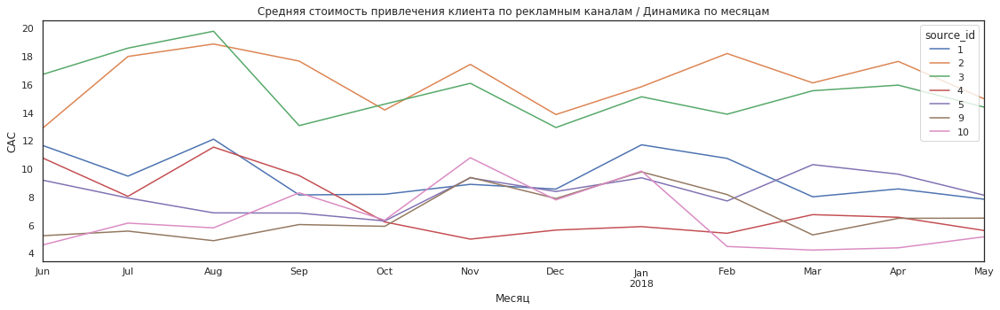

In [99]:
# график
pd.pivot_table(source_new,index = 'month_cost', columns='source_id',
               values='cac', aggfunc='mean').plot(figsize=(19,5))
plt.xlabel('Месяц')
plt.ylabel('CAC')
plt.title('Средняя стоимость привлечения клиента по рекламным каналам / Динамика по месяцам')

*Из граифка видно, что средняя стоимость привлечения клиента из 2 и 3 канала примерно одинакова, стоимость наивысшая среди всех каналов. На источник 2 потратили максимальную сумму (среднее значение на клиента) в феврале 2018, на 3 в марте. Для 5,9,10 каналов стоимость приблизительно одинакова.*

### Анализ выручки и стоимости привлечения по устройствам  <a class="anchor" id="section_3_3"></a>

In [100]:
# размер когорт по девайсам
device_cohort_sizes = orders_new_device.groupby(['device','first_day_order']).agg({'uid':'nunique'})
device_cohort_sizes = device_cohort_sizes.rename(columns={'uid':'device_cohort_size'})
device_cohort_sizes = device_cohort_sizes.reset_index()
device_cohort_sizes['first_day_order'] = pd.to_datetime(device_cohort_sizes['first_day_order'], format='%Y-%m-%d')
device_cohort_sizes.head(2)

,device,first_day_order,device_cohort_size
0,desktop,2017-06-01,75
1,desktop,2017-06-02,85


In [101]:
df_orders['revenue'].sum()

252053.77999999997

In [102]:
# рассчет суммарной выручки по дням, по клиентам, 
# добавление в таблицу с когортами по девайсу и дате первой покупки
orders_device_revenue = orders_new_device[['device','first_day_order','order_day','revenue']]
orders_device_revenue = orders_device_revenue.set_index(['device','first_day_order'])
orders_device_revenue.head(3)

order_day  revenue
device  first_day_order                     
desktop 2017-06-01       2017-06-01    17.00
        2017-06-01       2017-06-01     0.55
        2017-06-01       2017-06-01     0.37

In [103]:
new_join = device_cohort_sizes.set_index(['device','first_day_order']).join(orders_device_revenue)
new_join.head(5)

device_cohort_size   order_day  revenue
device  first_day_order                                         
desktop 2017-06-01                       75  2017-06-01    17.00
        2017-06-01                       75  2017-06-01     0.55
        2017-06-01                       75  2017-06-01     0.37
        2017-06-01                       75  2017-06-01     0.55
        2017-06-01                       75  2017-06-01     0.37

In [104]:
# проверка суммы (размер когорт с общим кол-вом тоже сошелся)
new_join['revenue'].sum()

252053.78

In [105]:
new_join = new_join.reset_index()
new_join['ltv'] = new_join['revenue'] / new_join['device_cohort_size']
new_join['order_day'] = pd.to_datetime(new_join['order_day'], format='%Y-%m-%d')
new_join['first_day_order'] = pd.to_datetime(new_join['first_day_order'], format='%Y-%m-%d')

new_join['order_month'] = new_join['order_day'].astype('datetime64[M]')
new_join['first_order_month'] = new_join['first_day_order'].astype('datetime64[M]')

new_join['age'] = (new_join['order_month'] - new_join['first_order_month']) / np.timedelta64(1,'M')
new_join['age'] = new_join['age'].round().astype('int')
new_join.sample(5)

,device,first_day_order,device_cohort_size,order_day,revenue,ltv,order_month,first_order_month,age
16513,desktop,2017-11-04,74,2017-11-04,3.67,0.049595,2017-11-01,2017-11-01,0
17371,desktop,2017-11-11,78,2017-11-11,2.44,0.031282,2017-11-01,2017-11-01,0
38021,desktop,2018-04-26,87,2018-04-26,3.67,0.042184,2018-04-01,2018-04-01,0
2063,desktop,2017-06-07,145,2017-06-07,2.20,0.015172,2017-06-01,2017-06-01,0
8105,desktop,2017-08-31,65,2017-08-31,9.17,0.141077,2017-08-01,2017-08-01,0


In [106]:
new_join['age'].unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11])

In [107]:
# сводная таблица с ltv
device_ltv_new = new_join.pivot_table(index = 'device', columns='age', values = 'ltv', aggfunc='mean')
device_ltv_new

age,0,1,2,3,4,5,6,7,8,9,10,11
device,,,,,,,,,,,,
desktop,0.054053,0.076326,0.102482,0.234480,0.110832,0.113846,0.096078,0.104566,0.104593,0.133682,0.159424,0.067472
touch,0.198796,0.267250,0.236161,0.286792,0.257040,0.326542,0.443762,0.333268,0.241325,0.450024,0.407079,1.098055


In [108]:
# сводная таблица с куммулятивным ltv
device_ltv_new = device_ltv_new.cumsum(axis=1)
device_ltv_new

age,0,1,2,3,4,5,6,7,8,9,10,11
device,,,,,,,,,,,,
desktop,0.054053,0.130379,0.232861,0.467341,0.578173,0.692019,0.788097,0.892662,0.997255,1.130937,1.290361,1.357833
touch,0.198796,0.466046,0.702207,0.989000,1.246039,1.572581,2.016343,2.349611,2.590936,3.040960,3.448039,4.546093


Text(93.5, 0.5, 'Устройство')

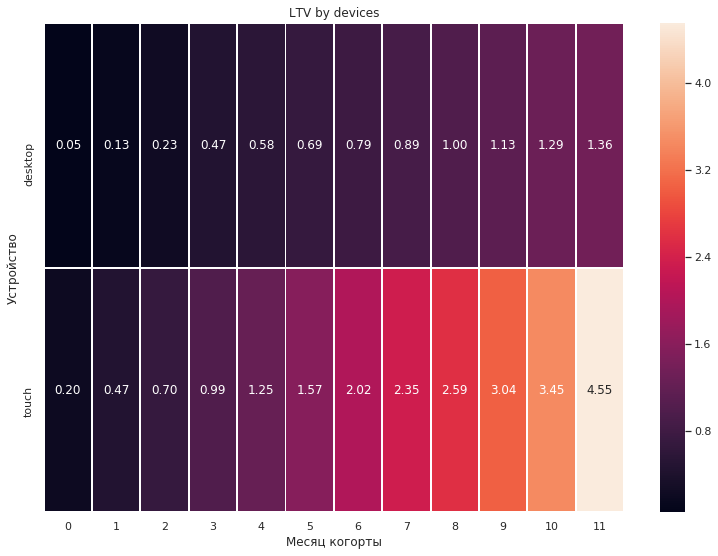

In [109]:
# тепловая карта ltv
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('LTV by devices')
sns.heatmap(device_ltv_new, annot=True, fmt='.2f', linewidths=1, linecolor='white')
plt.xlabel('Месяц когорты')
plt.ylabel('Устройство')

*Пользователи использующие тач скрин устройства приносят больше денег.*

Text(0.5, 1.0, 'Новые клиены в разреде устройств / Динамика по месяцам')

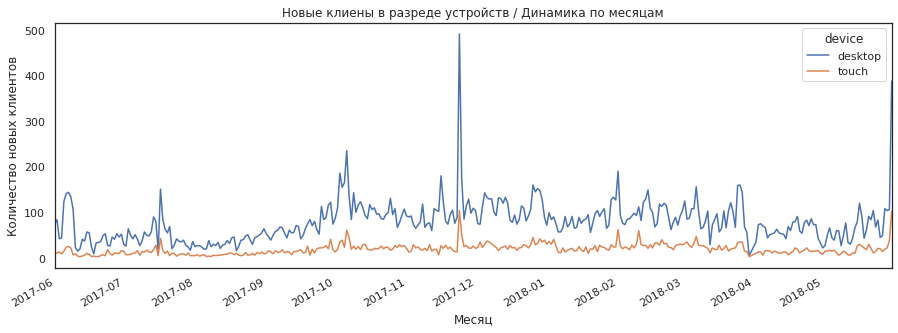

In [110]:
device_cohort_sizes.pivot_table(index='first_day_order',columns='device',values='device_cohort_size').plot(figsize=(15,5))
plt.xlabel('Месяц')
plt.ylabel('Количество новых клиентов')
plt.title('Новые клиены в разреде устройств / Динамика по месяцам')

*Количество пользователей на десктопах значительно больше. Несмотря на то, что стоимость привлечения пользователей десктопов выше, стоит обратить большее внимание на привлечение клиентов с носимыми устройствами, так как они приносят больше выручки.*

### Анализ выручки и стоимости привлечения по рекламным каналам <a class="anchor" id="section_3_4"></a>

In [111]:
orders_new_device.groupby('source_id')['uid'].nunique()

source_id
1      2899
2      3506
3     10473
4     10295
5      6931
7         1
9      1088
10     1329
Name: uid, dtype: int64

In [112]:
# рассчет суммарной выручки по дням, по истоникам, 
# добавление в таблицу с когортами по источнику и дате первой покупки
orders_source_revenue = orders_new_device[['source_id','first_day_order','order_day','revenue']]
orders_source_revenue = orders_source_revenue.set_index(['source_id','first_day_order'])
orders_source_revenue.sample(5)

order_day  revenue
source_id first_day_order                     
5         2017-10-28       2018-05-09    13.44
3         2017-08-25       2017-08-25     7.58
          2018-05-15       2018-05-15     9.17
          2018-02-17       2018-02-17     0.70
5         2018-05-16       2018-05-16     6.11

In [113]:
source_new = source_new.set_index(['source_id','first_day_order'])
source_new.head()

source_cohort_size   dt_costs  costs month_cost  \
source_id first_day_order                                                    
1         2017-06-01                       14 2017-06-01  75.20 2017-06-01   
          2017-06-02                        7 2017-06-02  62.25 2017-06-01   
          2017-06-03                        7 2017-06-03  36.53 2017-06-01   
          2017-06-04                        3 2017-06-04  55.00 2017-06-01   
          2017-06-05                       18 2017-06-05  57.08 2017-06-01   

                                 cac  
source_id first_day_order             
1         2017-06-01        5.371429  
          2017-06-02        8.892857  
          2017-06-03        5.218571  
          2017-06-04       18.333333  
          2017-06-05        3.171111

In [114]:
# общая таблица отчета
new_join_source = source_cohort_sizes.set_index(['source_id','first_day_order']).join(orders_source_revenue)
new_join_source = new_join_source.join(source_new['costs'])
new_join_source

source_cohort_size   order_day  revenue  costs
source_id first_day_order                                                
1         2017-06-01                       14  2017-06-01    17.00   75.2
          2017-06-01                       14  2017-06-01     1.22   75.2
          2017-06-01                       14  2017-06-02     0.85   75.2
          2017-06-01                       14  2017-06-02    12.83   75.2
          2017-06-01                       14  2017-06-04    17.11   75.2
...                                       ...         ...      ...    ...
10        2018-05-31                       35  2018-05-31     3.54   17.6
          2018-05-31                       35  2018-05-31     2.44   17.6
          2018-05-31                       35  2018-05-31     1.16   17.6
          2018-05-31                       35  2018-05-31     2.26   17.6
          2018-05-31                       35  2018-05-31     5.80   17.6

[50414 rows x 4 columns]

In [115]:
# проверка суммы 
new_join_source['revenue'].sum()

252053.77999999997

In [116]:
new_join_source = new_join_source.reset_index()

In [117]:
new_join_source

,source_id,first_day_order,source_cohort_size,order_day,revenue,costs
0,1,2017-06-01,14,2017-06-01,17.00,75.2
1,1,2017-06-01,14,2017-06-01,1.22,75.2
2,1,2017-06-01,14,2017-06-02,0.85,75.2
3,1,2017-06-01,14,2017-06-02,12.83,75.2
4,1,2017-06-01,14,2017-06-04,17.11,75.2
...,...,...,...,...,...,...
50409,10,2018-05-31,35,2018-05-31,3.54,17.6
50410,10,2018-05-31,35,2018-05-31,2.44,17.6
50411,10,2018-05-31,35,2018-05-31,1.16,17.6
50412,10,2018-05-31,35,2018-05-31,2.26,17.6


In [118]:
new_join_source['order_day'] = pd.to_datetime(new_join_source['order_day'], format='%Y-%m-%d')
new_join_source['first_day_order'] = pd.to_datetime(new_join_source['first_day_order'], format='%Y-%m-%d')

new_join_source['order_month'] = new_join_source['order_day'].astype('datetime64[M]')
new_join_source['first_order_month'] = new_join_source['first_day_order'].astype('datetime64[M]')

new_join_source['age'] = (new_join_source['order_month'] - new_join_source['first_order_month']) / np.timedelta64(1,'M')
new_join_source['age'] = new_join_source['age'].round().astype('int')
new_join_source

,source_id,first_day_order,source_cohort_size,order_day,revenue,costs,order_month,first_order_month,age
0,1,2017-06-01,14,2017-06-01,17.00,75.2,2017-06-01,2017-06-01,0
1,1,2017-06-01,14,2017-06-01,1.22,75.2,2017-06-01,2017-06-01,0
2,1,2017-06-01,14,2017-06-02,0.85,75.2,2017-06-01,2017-06-01,0
3,1,2017-06-01,14,2017-06-02,12.83,75.2,2017-06-01,2017-06-01,0
4,1,2017-06-01,14,2017-06-04,17.11,75.2,2017-06-01,2017-06-01,0
...,...,...,...,...,...,...,...,...,...
50409,10,2018-05-31,35,2018-05-31,3.54,17.6,2018-05-01,2018-05-01,0
50410,10,2018-05-31,35,2018-05-31,2.44,17.6,2018-05-01,2018-05-01,0
50411,10,2018-05-31,35,2018-05-31,1.16,17.6,2018-05-01,2018-05-01,0
50412,10,2018-05-31,35,2018-05-31,2.26,17.6,2018-05-01,2018-05-01,0


In [119]:
new_join_source['age'].unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11])

In [120]:
new_join_source['cac'] = new_join_source['costs'] / new_join_source['source_cohort_size']
new_join_source['ltv'] = new_join_source['revenue'] / new_join_source['source_cohort_size']
new_join_source['romi'] = new_join_source['ltv'] / new_join_source['cac']
new_join_source

,source_id,first_day_order,source_cohort_size,order_day,revenue,costs,order_month,first_order_month,age,cac,ltv,romi
0,1,2017-06-01,14,2017-06-01,17.00,75.2,2017-06-01,2017-06-01,0,5.371429,1.214286,0.226064
1,1,2017-06-01,14,2017-06-01,1.22,75.2,2017-06-01,2017-06-01,0,5.371429,0.087143,0.016223
2,1,2017-06-01,14,2017-06-02,0.85,75.2,2017-06-01,2017-06-01,0,5.371429,0.060714,0.011303
3,1,2017-06-01,14,2017-06-02,12.83,75.2,2017-06-01,2017-06-01,0,5.371429,0.916429,0.170612
4,1,2017-06-01,14,2017-06-04,17.11,75.2,2017-06-01,2017-06-01,0,5.371429,1.222143,0.227527
...,...,...,...,...,...,...,...,...,...,...,...,...
50409,10,2018-05-31,35,2018-05-31,3.54,17.6,2018-05-01,2018-05-01,0,0.502857,0.101143,0.201136
50410,10,2018-05-31,35,2018-05-31,2.44,17.6,2018-05-01,2018-05-01,0,0.502857,0.069714,0.138636
50411,10,2018-05-31,35,2018-05-31,1.16,17.6,2018-05-01,2018-05-01,0,0.502857,0.033143,0.065909
50412,10,2018-05-31,35,2018-05-31,2.26,17.6,2018-05-01,2018-05-01,0,0.502857,0.064571,0.128409


In [121]:
source_cac = new_join_source.pivot_table(index='source_id',columns='age', values ='cac', aggfunc = 'mean')
source_cac = source_cac.fillna(0)
source_cac

age,0,1,2,3,4,5,6,7,8,9,10,11
source_id,,,,,,,,,,,,
1,7.202453,7.375445,5.922733,6.311897,5.555338,5.577090,5.995973,6.245588,6.220471,4.887145,4.902525,3.940282
2,12.228350,11.928828,11.393776,11.874702,12.128959,12.318248,10.856246,9.995139,10.515789,11.350251,10.121650,10.084591
3,13.469984,14.047332,13.661127,13.402905,13.145665,13.633254,13.144091,14.696150,13.512218,17.954301,17.011317,11.447977
4,5.907759,5.861720,6.246130,5.885385,5.520204,6.393971,6.329432,5.860811,6.604255,5.882123,7.886292,10.307456
5,7.482553,7.565515,7.107899,5.774492,6.244512,5.972128,6.710556,6.350959,6.298084,6.089454,7.411649,5.702879
9,4.372289,4.400615,4.788958,4.126902,4.602507,3.378962,2.555437,3.029148,4.062111,3.879881,6.390000,0.000000
10,4.032265,3.738407,3.188246,4.332825,4.456245,4.882861,3.435746,2.895512,2.411746,5.660000,0.000000,0.000000


Text(93.5, 0.5, 'Источник привлечения клиента')

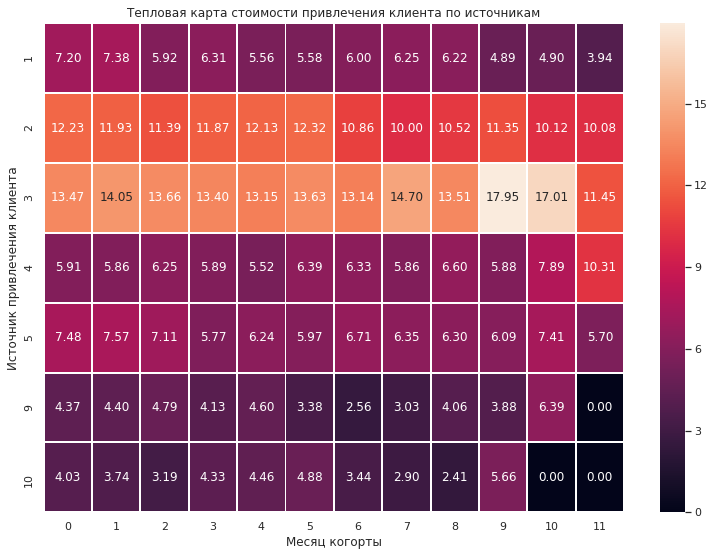

In [122]:
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('CAC by sources')
sns.heatmap(source_cac, annot=True, fmt='.2f', linewidths=1, linecolor='white')
plt.title('Тепловая карта стоимости привлечения клиента по источникам')
plt.xlabel('Месяц когорты')
plt.ylabel('Источник привлечения клиента')

*Средняя стоимость привлечения клиента наивысшая для 2 и 3 источника рекламы.*

In [123]:
# ltv
source_ltv = new_join_source.pivot_table(index='source_id',columns='age', values ='ltv', aggfunc = 'mean')
source_ltv = source_ltv.fillna(0)
source_ltv

age,0,1,2,3,4,5,6,7,8,9,10,11
source_id,,,,,,,,,,,,
1,0.633239,1.065885,1.149416,1.019812,0.769732,0.568173,0.629224,1.792235,1.276922,1.177328,0.901673,0.735134
2,0.533534,0.706645,1.193535,2.024667,1.213909,1.389378,1.299072,0.694069,0.729551,0.815373,1.615061,0.648531
3,0.142912,0.203418,0.175303,0.222231,0.200799,0.206621,0.128399,0.174836,0.244726,0.253499,0.232193,0.060795
4,0.146214,0.153454,0.126349,0.233375,0.245313,0.304503,0.443406,0.305207,0.244382,0.547922,1.183783,0.209057
5,0.219804,0.307907,0.385585,1.951346,0.340036,0.554701,0.326972,0.302369,0.273492,0.670468,0.412411,0.243493
7,1.220000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,0.940840,1.023971,1.673446,1.349036,0.877729,0.829364,1.062075,1.318839,2.148425,1.117827,2.628333,0.000000
10,0.698701,0.577752,0.617299,0.679992,0.296059,0.785795,0.222460,0.429287,0.302619,0.560000,0.000000,0.000000


In [124]:
# куммулятивный ltv
source_ltv = source_ltv.cumsum(axis = 1)
source_ltv

age,0,1,2,3,4,5,6,7,8,9,10,11
source_id,,,,,,,,,,,,
1,0.633239,1.699124,2.848539,3.868351,4.638083,5.206256,5.835480,7.627715,8.904637,10.081965,10.983638,11.718772
2,0.533534,1.240179,2.433714,4.458381,5.672291,7.061669,8.360741,9.054810,9.784361,10.599734,12.214795,12.863325
3,0.142912,0.346330,0.521633,0.743864,0.944663,1.151284,1.279683,1.454519,1.699244,1.952743,2.184936,2.245732
4,0.146214,0.299668,0.426017,0.659392,0.904705,1.209207,1.652613,1.957820,2.202202,2.750124,3.933908,4.142964
5,0.219804,0.527711,0.913296,2.864641,3.204677,3.759378,4.086349,4.388718,4.662210,5.332678,5.745089,5.988582
7,1.220000,1.220000,1.220000,1.220000,1.220000,1.220000,1.220000,1.220000,1.220000,1.220000,1.220000,1.220000
9,0.940840,1.964812,3.638258,4.987294,5.865022,6.694387,7.756462,9.075301,11.223726,12.341553,14.969887,14.969887
10,0.698701,1.276454,1.893753,2.573745,2.869804,3.655599,3.878059,4.307346,4.609965,5.169965,5.169965,5.169965


Text(93.5, 0.5, 'Источник привлечения клиента')

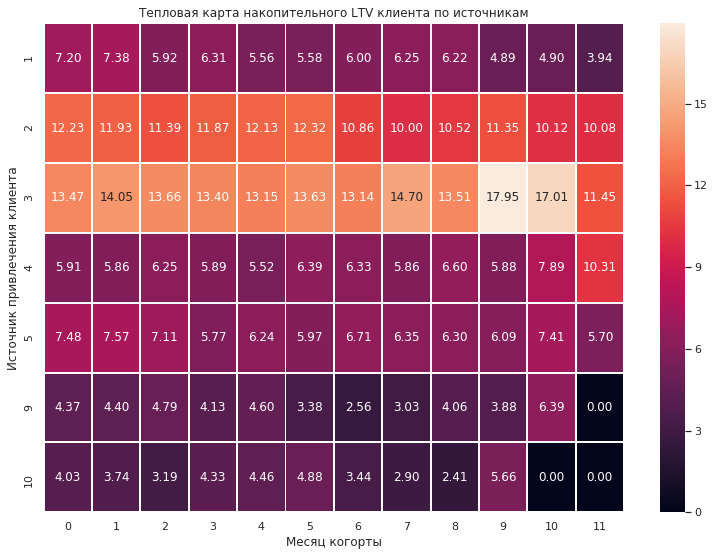

In [125]:
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('LTV by sources')
sns.heatmap(source_cac, annot=True, fmt='.2f', linewidths=1, linecolor='white')
plt.title('Тепловая карта накопительного LTV клиента по источникам')
plt.xlabel('Месяц когорты')
plt.ylabel('Источник привлечения клиента')

*Несмотря на высокую стоимость привлечения клиента, клиенты, пришедшие из 2 и 3 исотчников рекламы, приносят наибольшую выручку, также 4 кканал спустя год показал уровень каналов. 2-3*

### ROMI <a class="anchor" id="section_3_5"></a>

In [126]:
# romi по источникам
source_romi = new_join_source.pivot_table(index='source_id',columns='age', values ='romi', aggfunc = 'mean')
source_romi = source_romi.fillna(0)
source_romi

age,0,1,2,3,4,5,6,7,8,9,10,11
source_id,,,,,,,,,,,,
1,0.099938,0.205670,0.170857,0.155881,0.131657,0.100947,0.099453,0.231114,0.159184,0.171058,0.178257,0.205000
2,0.043208,0.062045,0.088234,0.145280,0.091126,0.105263,0.122631,0.071404,0.070414,0.068982,0.153120,0.054010
3,0.011931,0.016176,0.013157,0.017613,0.015827,0.015619,0.010282,0.011276,0.017472,0.013848,0.014361,0.004087
4,0.109443,0.105887,0.100782,0.370106,0.339246,1.546282,1.510999,0.625905,0.564374,4.079205,10.886173,0.035124
5,0.031399,0.042566,0.055480,0.485143,0.067392,0.128392,0.054063,0.048103,0.047226,0.099500,0.046647,0.043951
9,0.227678,0.240473,0.394878,0.378874,0.226998,0.236792,0.478067,0.447095,0.649411,0.324089,0.406265,0.000000
10,0.242451,0.278116,0.174071,0.311524,0.123237,0.116464,0.066839,0.146021,0.133761,0.098940,0.000000,0.000000


In [127]:
# куммулятивный romi
source_romi = source_romi.cumsum(axis = 1)
source_romi

age,0,1,2,3,4,5,6,7,8,9,10,11
source_id,,,,,,,,,,,,
1,0.099938,0.305607,0.476465,0.632346,0.764003,0.864950,0.964404,1.195518,1.354702,1.525760,1.704017,1.909017
2,0.043208,0.105254,0.193488,0.338768,0.429893,0.535157,0.657788,0.729192,0.799606,0.868589,1.021709,1.075719
3,0.011931,0.028107,0.041264,0.058877,0.074704,0.090323,0.100605,0.111881,0.129353,0.143201,0.157561,0.161648
4,0.109443,0.215330,0.316112,0.686218,1.025465,2.571747,4.082746,4.708651,5.273026,9.352231,20.238404,20.273528
5,0.031399,0.073966,0.129446,0.614589,0.681981,0.810373,0.864436,0.912539,0.959765,1.059265,1.105912,1.149863
9,0.227678,0.468152,0.863030,1.241904,1.468903,1.705695,2.183761,2.630857,3.280268,3.604356,4.010622,4.010622
10,0.242451,0.520567,0.694639,1.006163,1.129400,1.245864,1.312703,1.458724,1.592485,1.691425,1.691425,1.691425


Text(93.5, 0.5, 'Источник привлечения клиента')

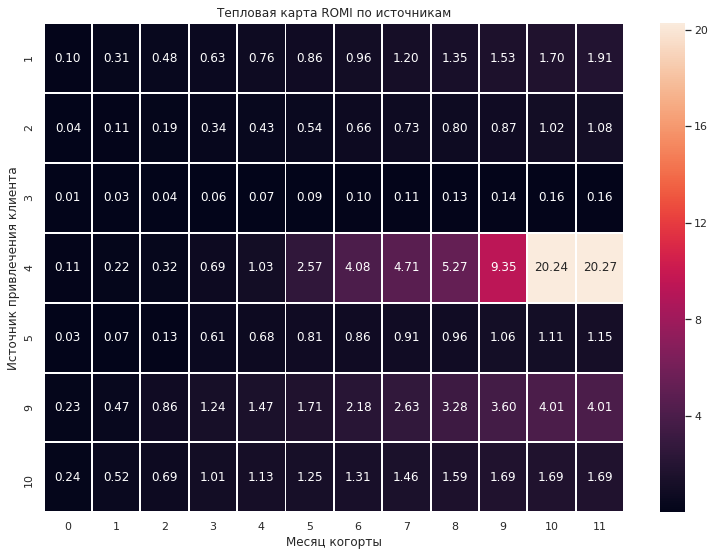

In [128]:
sns.set(style='white')
plt.figure(figsize=(13, 9))
plt.title('ROMI by sources')
sns.heatmap(source_romi, annot=True, fmt='.2f', linewidths=1, linecolor='white')
plt.title('Тепловая карта ROMI по источникам')
plt.xlabel('Месяц когорты')
plt.ylabel('Источник привлечения клиента')

In [129]:
# средняя когорта
source_romi.cumsum(axis=1).mean(axis=0)

age
0      0.109436
1      0.354719
2      0.742497
3      1.396620
4      2.192956
5      3.310686
6      4.763035
7      6.441230
8      8.353973
9     10.960377
10    15.236041
11    19.560587
dtype: float64

*В среднем, рекламные затраты на привлечение клиентов окупаются спустя 3 месяца, на 4 месяц жизни когорты. Наибольшая окупаемость у истоника 4, клиенты спустя пол года принесли денег в 4 раза больше рекламных бюджетов. Быстрее всего окупается источник 9, а медленне всего - источник 3 (спустя год он не окупился). Возможно, оценивая стоимость источника 2, бюджет можно сократить (клиентов приводим много, но инвестиции не окупаются, но это зависит от целей бизнеса.)*

## Выводы и рекомендации <a class="anchor" id="chapter5"></a>

Как и для любого бизнеса, для Яндекс.Афиши характерна сезонность. Наибольшее количество визитов и покупок совершается с октября по декабрь, в период холодов и в предверии нового года, когда люди склонны тратить деньги на развлечения в помещении. На это период приходятся наибольшие затраты на рекламу.

Компания использует 7 каналов рекламы, 7 источников привлечения клиентов. Наибольшее количество клиентов приходит из каналов номер 4 и 3. На канал 3 тратится наибольший бюджет, однако именно этот канал имеет наименьший парамент окупаемости: спустя 12 месяцев ROMI 0.16. Клиенты, пришедшие из канала 4 принесли выручку, окупившую инвестиции на 4 месяц. Наиболее быстрым в контексте окупаемости оказался источники 9 и 10, они привели немного клиентов, возможно маркетологам стоит обратить внимание на данный канал и увеличить бюджеты на привлечение клиентов посредством этого канала.
Также, стоит отметить, что клиенты, сделавшие первый заказ в июне и декабре показывают наилучшие результаты LTV, стоит обратить внимание на способы привлечения клиентов в данный период.